In [1]:
%%capture
#!/usr/bin/env python
from past.utils import old_div
# try:
#     get_ipython().magic(u'load_ext autoreload')
#     get_ipython().magic(u'autoreload 2')
#     get_ipython().magic(u'matplotlib qt')
# except:
#     pass

# import logging
import matplotlib.pyplot as plt
import numpy as np

# logging.basicConfig(format=
#                           "%(relativeCreated)12d [%(filename)s:%(funcName)20s():%(lineno)s] [%(process)d] %(message)s",
#                     # filename="/tmp/caiman.log",
#                     level=logging.DEBUG)

import caiman as cm
# from caiman.source_extraction import cnmf
# from caiman.utils.utils import download_demo
# from caiman.utils.visualization import inspect_correlation_pnr, nb_inspect_correlation_pnr
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import params as params
# from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
import cv2

try:
    cv2.setNumThreads(0)
except:
    pass
# import bokeh.plotting as bpl
# import holoviews as hv

# bpl.output_notebook()
# hv.notebook_extension('bokeh')

# import matplotlib

# matplotlib.get_backend()

# import os

%matplotlib inline

%config InlineBackend.figure_format = 'retina'
def showMovie(m_show, figsize = (6,6), out="jshtml",fps = 10):
    from IPython.display import HTML
    import matplotlib.pyplot as plt
    from matplotlib import animation
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(m_show[0].T, cmap="Greys", vmin=0, vmax=m_show.max())
    plt.close(fig)
    def init():
        im.set_data(m_show[0].T)
        return (im,)
    def animate(i):
        im.set_data(m_show[i].T)
        return (im,)
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(m_show),
                                   interval=1000/fps,
                                   blit=True
                                  )
    if out=="html5":
        return HTML(anim.to_html5_video())
    if out=="jshtml":
        return HTML(anim.to_jshtml())

### Setup a cluster
To enable parallel processing a (local) cluster needs to be set up. This is done with a cell below. The variable `backend` determines the type of cluster used. The default value `'local'` uses the multiprocessing package. The `ipyparallel` option is also available. More information on these choices can be found [here](https://github.com/flatironinstitute/CaImAn/blob/master/CLUSTER.md). The resulting variable `dview` expresses the cluster option. If you use `dview=dview` in the downstream analysis then parallel processing will be used. If you use `dview=None` then no parallel processing will be employed.

In [2]:
# from sys import path as syspath
# syspath.append("/Users/srdjan/Documents/Physio_Ca/functions/")
# from physio_def_1 import *

In [3]:
#%% start a cluster for parallel processing (if a cluster already exists it will be closed and a new session will be opened)
if 'dview' in locals():
    cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

# Motion correction 

## Initialize motion correction

In [4]:
# del fname_after_rigid

In [5]:
fname = 'Experiment45b_2_Series007_f=0.17Hz_d1_128_d2_128_d3_1_order_C_frames_256_.mmap'

In [6]:
# motion correction parameters
opts = params.CNMFParams(params_dict={
    'fnames'    : fname,
#     'fr'        : 0.04,      # movie frame rate
#     'decay_time': 200,       # length of a typical transient in seconds
#     'max_shifts': (3, 3),    # maximum allowed rigid shift
    'border_nan': "copy",
    'pw_rigid'  : False,
    'gSig_filt' : (1, 1),         # size of high pass spatial filtering, used in 1p data,
}) 

In [7]:
mc = MotionCorrect(fname, dview=dview, **opts.get_group('motion'))

In [8]:
m_working = cm.load(fname)

In [9]:
# showMovie(m_after_rigidmc.resize(1,1,100/len(m_after_rigidmc)))

In [10]:
mc.pw_rigid = False  # turn the flag to True for pw-rigid motion correction
mc.motion_correct(save_movie=True)

/opt/tljh/user/envs/physio/lib/python3.7/site-packages/caiman/base/movies.py:416: RuntimeWarning: invalid value encountered in log
  log_xm1_y = np.log(res[sh_x - 1, sh_y])
/opt/tljh/user/envs/physio/lib/python3.7/site-packages/caiman/base/movies.py:417: RuntimeWarning: invalid value encountered in log
  log_xp1_y = np.log(res[sh_x + 1, sh_y])
/opt/tljh/user/envs/physio/lib/python3.7/site-packages/caiman/base/movies.py:418: RuntimeWarning: invalid value encountered in log
  log_x_ym1 = np.log(res[sh_x, sh_y - 1])
/opt/tljh/user/envs/physio/lib/python3.7/site-packages/caiman/base/movies.py:419: RuntimeWarning: invalid value encountered in log
  log_x_yp1 = np.log(res[sh_x, sh_y + 1])


In [ ]:
mc.

In [21]:
showMovie(m_after_rigidmc.resize(1,1,100/len(m_after_rigidmc)))

## Piecewise

In [17]:
dims = m_after_rigidmc.shape[1:]

In [17]:
# # equal number of strides
# nStrides = 3
# Lstride, Loverlap = m_after_rigidmc.shape[1]//nStrides, m_after_rigidmc.shape[1]%nStrides
# print (Lstride, Loverlap, nStrides**2)
# mc.strides  = (Lstride,)*2   # start a new patch for pw-rigid motion correction every x pixels,
# mc.overlaps = (Loverlap,)*2  # between pathes (size of patch strides+overlaps),
# mc.max_deviation_rigid = 3   # maximum deviation allowed for patch with respect to rigid shifts

In [18]:
nStridesX, nStridesY = 10,10
LstrideX, LoverlapX = dims[0]//nStridesX, dims[0]%nStridesX  
LstrideY, LoverlapY = dims[1]//nStridesY, dims[1]%nStridesY  

mc.strides  = ( LstrideX,  LstrideY)   # start a new patch for pw-rigid motion correction every x pixels,
mc.overlaps = (LoverlapX, LoverlapY)   # between pathes (size of patch strides+overlaps),
mc.max_deviation_rigid = 10             # maximum deviation allowed for patch with respect to rigid shifts

In [19]:
mc.pw_rigid = True  # turn the flag to True for pw-rigid motion correction
# mc.template = mc.mmap_file  # use the template obtained before to save in computation (optional)
mc.motion_correct(save_movie=True)

In [159]:
fname_after_pw = mc.fname_tot_els[0]

In [160]:
m_after_pwmc = cm.load(fname_after_pw)
# m_after_pwmc.fr = m_orig.fr

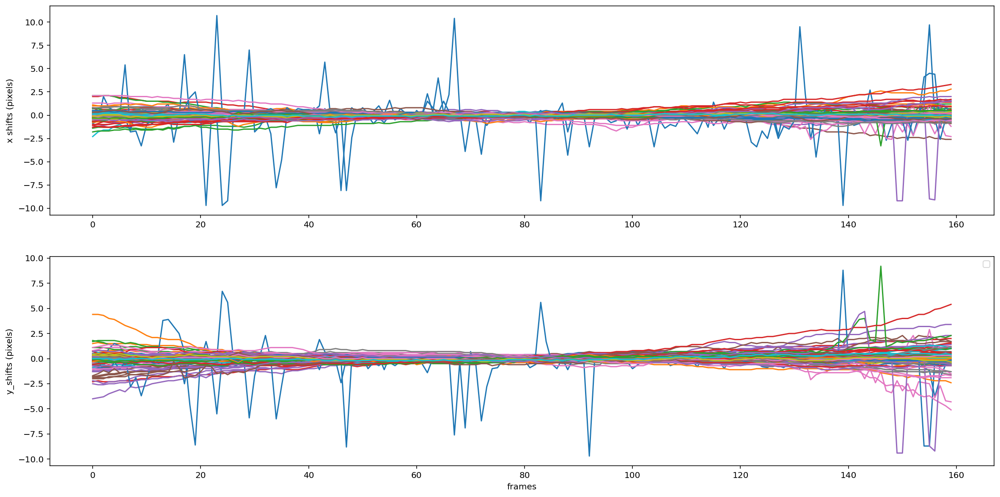

In [161]:
mc.x_shifts_els = np.array(mc.x_shifts_els)
mc.y_shifts_els = np.array(mc.y_shifts_els)

#%% visualize elastic shifts
plt.close()
plt.figure(figsize = (20,10))
plt.subplot(2, 1, 1)
for i in range(mc.x_shifts_els.shape[1]):
    plt.plot(mc.x_shifts_els[:,i], label=i)
if i<40:    plt.legend(ncol=4)
plt.ylabel('x shifts (pixels)')
plt.subplot(2, 1, 2)
plt.plot(mc.y_shifts_els)
plt.ylabel('y_shifts (pixels)')
plt.xlabel('frames')
plt.legend(ncol=4)
#%% compute borders to exclude
bord_px_els = np.ceil(np.maximum(np.max(np.abs(mc.x_shifts_els)),
                                 np.max(np.abs(mc.y_shifts_els)))).astype(np.int)

In [162]:
absshifts = (mc.y_shifts_els**2+mc.x_shifts_els**2)**.5

In [163]:
absshifts.shape

(160, 100)

100

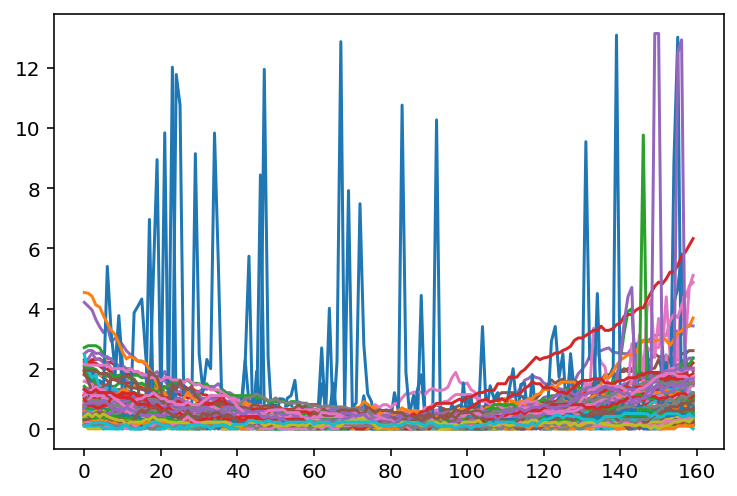

In [164]:
len(plt.plot(absshifts))

In [165]:
largestShiftIds = np.argsort(-np.abs(absshifts).mean(axis=0))

Text(0.5, 0, 'frames')

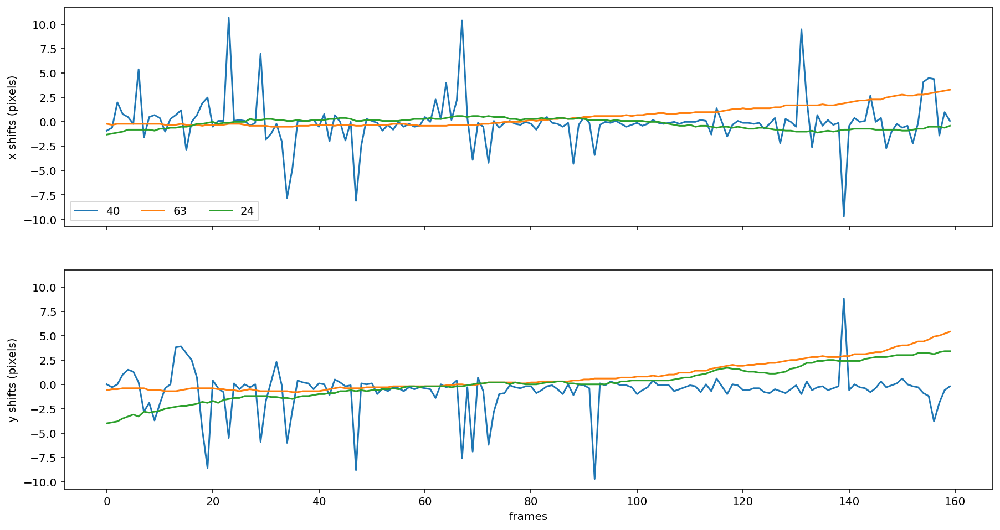

In [167]:
fig, (axx,axy) = plt.subplots(2,1,figsize = (15,8), sharex=True, sharey=True)
for iShift in largestShiftIds[:3]:
    axx.plot(mc.x_shifts_els[:,iShift], label=iShift)
    axy.plot(mc.y_shifts_els[:,iShift], label=iShift)
axx.set_ylabel('x shifts (pixels)')
axy.set_ylabel('y shifts (pixels)')
axx.legend(ncol=4)
axy.set_xlabel('frames')

In [183]:
iShift = 24#nStridesX-1
ixShift, iyShift = iShift//nStridesX, iShift%nStridesX
# ixShift, iyShift = nStridesX-1,nStridesY-1
ixShift, iyShift

(2, 4)

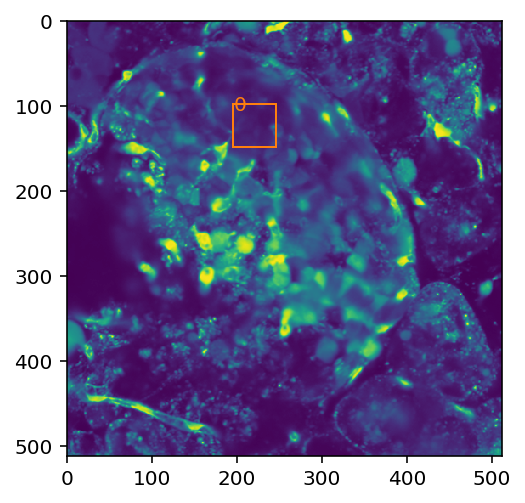

In [184]:
ax = plt.subplot(111)
ax.imshow(m_after_pwmc[::10].mean(0))
addRoisToImage([(
    iyShift*(LstrideY-LoverlapY),
    ixShift*(LstrideX-LoverlapX),
)],LstrideX,ax=ax)

In [190]:
ix = (
    slice(None),
    slice(ixShift*(LstrideX-LoverlapX)-10,ixShift*(LstrideX-LoverlapX)+LstrideX+10),
    slice(iyShift*(LstrideY-LoverlapY)-10,iyShift*(LstrideY-LoverlapY)+LstrideY+10),
     )

In [191]:
# ix = (slice(None), slice(None), slice(None))
# ix=slice(None)
cm.concatenate([
    m_after_rigidmc[ix],
    np.ones_like(m_after_rigidmc)[ix][:,:,:10]*np.nan,
    m_after_pwmc[ix],
],axis=2).play(fr=30,do_loop=True, magnification = 1)

In [144]:
cm.movie??

# CNMF-E

In [71]:
(512-32)/48

10.0

In [73]:
# parameters for source extraction and deconvolution
p = 1               # order of the autoregressive system
K = None            # upper bound on number of components per patch, in general None
gSig = ( 7,  7)     # gaussian width of a 2D gaussian kernel, which approximates a neuron
gSiz = (29, 29)     # average diameter of a neuron, in general 4*gSig+1
# Ain = None        # possibility to seed with predetermined binary masks
merge_thr = .7      # merging threshold, max correlation allowed
rf = 48             # half-size of the patches in pixels. e.g., if rf=40, patches are 80x80
stride_cnmf = 32    # amount of overlap between the patches in pixels
#                     (keep it at least large as gSiz, i.e 4 times the neuron size gSig)
tsub = 1            # downsampling factor in time for initialization,
#                     increase if you have memory problems
ssub = 1            # downsampling factor in space for initialization,
#                     increase if you have memory problems
#                     you can pass them here as boolean vectors
low_rank_background = None  # None leaves background of each patch intact,
#                     True performs global low-rank approximation if gnb>0
gnb = 0             # number of background components (rank) if positive,
#                     else exact ring model with following settings
#                         gnb= 0: Return background as b and W
#                         gnb=-1: Return full rank background B
#                         gnb<-1: Don't return background
nb_patch = 0        # number of background components (rank) per patch if gnb>0,
#                     else it is set automatically
# min_corr = .8       # min peak value from correlation image
# min_pnr = 10        # min peak to noise ration from PNR image
ssub_B = 4          # additional downsampling factor in space for background
ring_size_factor = 1.4  # radius of ring is gSiz*ring_size_factor

opts.change_params(params_dict={'method_init': 'corr_pnr',  # use this for 1 photon
                                'K': K,
                                'gSig': gSig,
                                'gSiz': gSiz,
                                'merge_thr': merge_thr,
                                'p': p,
                                'tsub': tsub,
                                'ssub': ssub,
                                'rf': rf,
                                'stride': stride_cnmf,
                                'only_init': True,    # set it to True to run CNMF-E
                                'nb': gnb,
                                'nb_patch': nb_patch,
                                'method_deconvolution': 'oasis',       # could use 'cvxpy' alternatively
                                'low_rank_background': low_rank_background,
                                'update_background_components': True,  # sometimes setting to False improve the results
#                                 'min_corr': min_corr,
#                                 'min_pnr': min_pnr,
                                'normalize_init': False,               # just leave as is
                                'center_psf': True,                    # leave as is for 1 photon
                                'ssub_B': ssub_B,
                                'ring_size_factor': ring_size_factor,
                                'del_duplicates': True,                # whether to remove duplicates from initialization
#                                 'border_pix': bord_px
                               })                # number of pixels to not consider in the borders)

CNMFParams:

data:

{'caiman_version': '1.6.3',
 'decay_time': 200,
 'dims': (512, 512),
 'dxy': (1, 1),
 'fnames': ['memmap__d1_512_d2_512_d3_1_order_C_frames_160_.mmap'],
 'fr': 0.04,
 'last_commit': 'FILE-1571404903',
 'mmap_C': None,
 'mmap_F': None,
 'var_name_hdf5': 'mov'}

spatial_params:

{'block_size_spat': 5000,
 'dist': 3,
 'expandCore': array([[0, 0, 1, 0, 0],
       [0, 1, 1, 1, 0],
       [1, 1, 1, 1, 1],
       [0, 1, 1, 1, 0],
       [0, 0, 1, 0, 0]]),
 'extract_cc': True,
 'maxthr': 0.1,
 'medw': None,
 'method_exp': 'dilate',
 'method_ls': 'lasso_lars',
 'n_pixels_per_process': None,
 'nb': 0,
 'normalize_yyt_one': True,
 'nrgthr': 0.9999,
 'num_blocks_per_run_spat': 20,
 'se': array([[1, 1, 1],
       [1, 1, 1],
       [1, 1, 1]], dtype=uint8),
 'ss': array([[1, 1, 1],
       [1, 1, 1],
       [1, 1, 1]], dtype=uint8),
 'thr_method': 'nrg',
 'update_background_components': True}

temporal_params:

{'ITER': 2,
 'bas_nonneg': False,
 'block_size_temp': 5000,
 'fudge_fa

In [78]:
cn_filter, pnr = cm.summary_images.correlation_pnr(m_after_pwmc, gSig=gSig[0], swap_dim=False) # change swap dim if output looks weird, it is a problem with tiffile

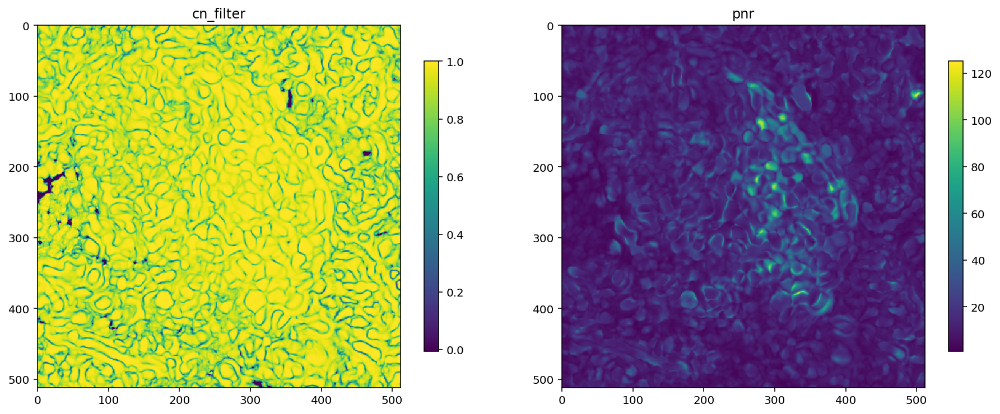

In [90]:
fig = plt.figure(figsize=(13,4.5))
axs = [
    fig.add_axes([0,0,.45,1]),
    fig.add_axes([.5,0,.45,1])
]
for ax,t in zip(axs,["cn_filter", "pnr"]):
    ax.set_title(t)
    m = eval(t)
    im = ax.imshow(m)
    plt.colorbar(im, ax=ax, shrink = .8)

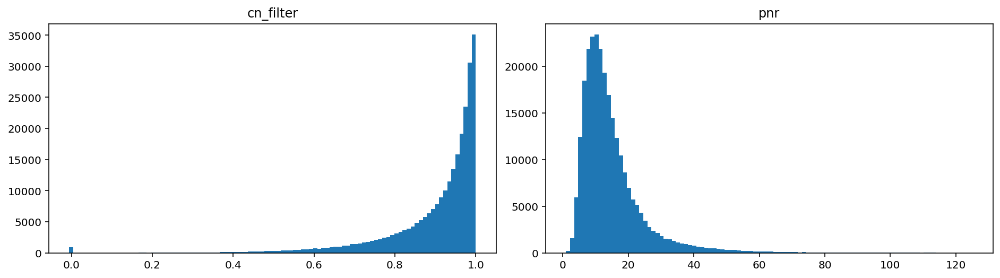

In [91]:
fig = plt.figure(figsize=(13,3))
axs = [
    fig.add_axes([0,0,.45,1]),
    fig.add_axes([.5,0,.45,1])
]
for ax,t in zip(axs,["cn_filter", "pnr"]):
    ax.set_title(t)
    m = eval(t)
    ax.hist(m.flatten(),100)

In [93]:
# opts.get("min_corr")

In [110]:
cnm.params

CNMFParams:

data:

{'caiman_version': '1.6.3',
 'decay_time': 200,
 'dims': (512, 512),
 'dxy': (1, 1),
 'fnames': ['memmap__d1_512_d2_512_d3_1_order_C_frames_160_.mmap'],
 'fr': 0.04,
 'last_commit': 'FILE-1571404903',
 'mmap_C': None,
 'mmap_F': None,
 'var_name_hdf5': 'mov'}

spatial_params:

{'block_size_spat': 5000,
 'dist': 3,
 'expandCore': array([[0, 0, 1, 0, 0],
       [0, 1, 1, 1, 0],
       [1, 1, 1, 1, 1],
       [0, 1, 1, 1, 0],
       [0, 0, 1, 0, 0]]),
 'extract_cc': True,
 'maxthr': 0.1,
 'medw': None,
 'method_exp': 'dilate',
 'method_ls': 'lasso_lars',
 'n_pixels_per_process': None,
 'nb': 0,
 'normalize_yyt_one': True,
 'nrgthr': 0.9999,
 'num_blocks_per_run_spat': 20,
 'se': array([[1, 1, 1],
       [1, 1, 1],
       [1, 1, 1]], dtype=uint8),
 'ss': array([[1, 1, 1],
       [1, 1, 1],
       [1, 1, 1]], dtype=uint8),
 'thr_method': 'nrg',
 'update_background_components': True}

temporal_params:

{'ITER': 2,
 'bas_nonneg': False,
 'block_size_temp': 5000,
 'fudge_fa

In [125]:
cnm = cnmf.CNMF(n_processes=n_processes,
                dview=dview,
                Ain=None,
                params=opts)

In [126]:
fname_mc  = mc.fname_tot_els
fname_new = cm.save_memmap(fname_mc, base_name='memmap_', order='C')

In [127]:
# load memory mappable file
Yr, dims, T = cm.load_memmap(fname_new)
images = Yr.T.reshape((T,) + dims, order='F')

In [128]:
cm.movie(images).play(fr=100)

In [129]:
cnm.fit(images)

/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input leng

/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input length  = 160, using nperseg = 160
  .format(nperseg, input_length))
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/scipy/signal/spectral.py:1969: UserWarning: nperseg = 256 is greater than input leng

In [130]:
#%% COMPONENT EVALUATION
# the components are evaluated in three ways:
#   a) the shape of each component must be correlated with the data
#   b) a minimum peak SNR is required over the length of a transient
#   c) each shape passes a CNN based classifier

min_SNR = 3            # adaptive way to set threshold on the transient size
r_values_min = 0.85    # threshold on space consistency (if you lower more components
#                        will be accepted, potentially with worst quality)
cnm.params.set('quality', {'min_SNR': min_SNR,
                           'rval_thr': r_values_min,
                           'use_cnn': False})
cnm.estimates.evaluate_components(images, cnm.params, dview=dview)

print(' ***** ')
print('Number of total components: ', len(cnm.estimates.C))
print('Number of accepted components: ', len(cnm.estimates.idx_components))

 ***** 
Number of total components:  580
Number of accepted components:  377


In [133]:
#%% plot contour plots of accepted and rejected components
cnm.estimates.plot_contours_nb(img=cn_filter, idx=cnm.estimates.idx_components)

In [134]:
# accepted components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)

In [135]:
# rejected components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components_bad,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)

In [141]:
maxDims = []
for coords in cnm.estimates.coordinates:
    maxDims += [np.max(np.nanmax(coords["coordinates"][1:-1],axis=0)-
                       np.nanmin(coords["coordinates"][1:-1],axis=0))]

maxDims = np.array(maxDims)

In [148]:
from matplotlib.colors import LogNorm

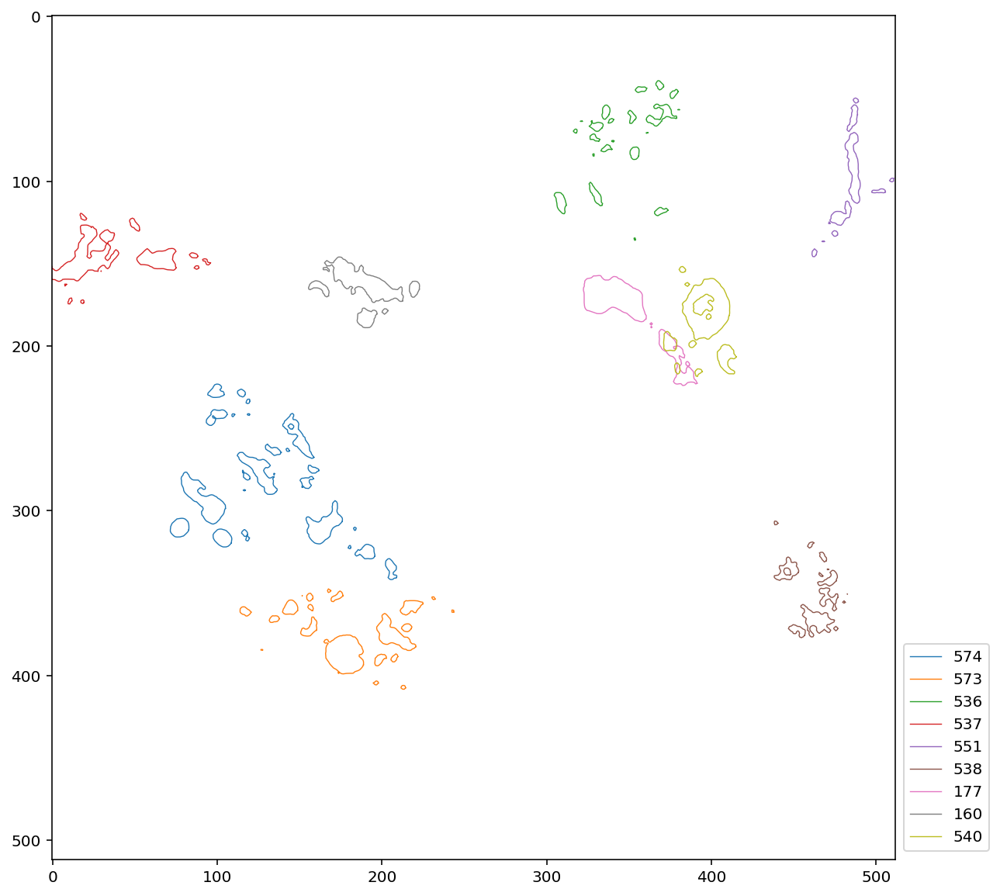

In [158]:
plt.figure(figsize=(10,10))
ax = plt.subplot(111)
ax.imshow(cn_filter, cmap='Greys',vmax=1000)


for i in np.argsort(-maxDims)[:9]:
    x,y = cnm.estimates.coordinates[i]["coordinates"].T
    ax.plot(x-.5,y-.5,lw=.7,label=i)
ax.set_aspect("equal")
ax.legend(loc=(1.01,.01))

# Understanding elements of the estimates

In [179]:
Ncomps = len(cnm.estimates.coordinates)

## A: set of spatial footprints

In [178]:
A = cnm.estimates.A

(262144, 580)

In [192]:
A.dtype, A.shape == (np.prod(images.shape[1:]), Ncomps)

(dtype('float64'), True)

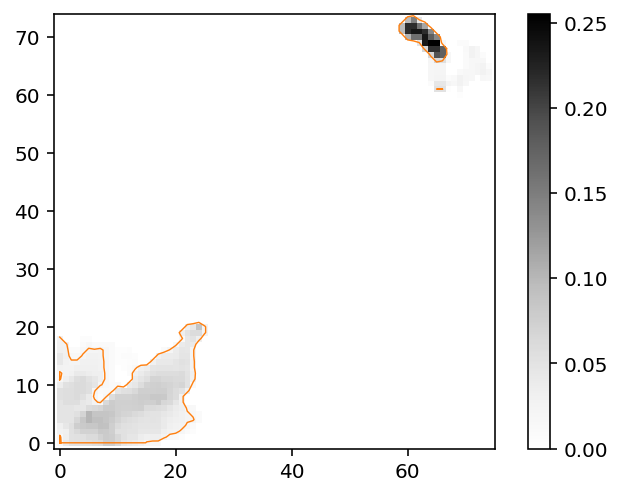

In [248]:
iComps = np.array([2,3])
a = np.asarray(A[:,iComps].todense()).sum(-1).reshape(dims)
ax = plt.subplot(111)
i,j = np.where(a>0)
im = ax.imshow(a.T,cmap="Greys")
plt.xlim(i.min()-1, i.max()+1)
plt.ylim(j.min()-1, j.max()+1)
plt.colorbar(im)
for iComp in iComps:
    x,y = cnm.estimates.coordinates[iComp]["coordinates"].T
    plt.plot(x,y,"C1",lw=.7)
ax.set_aspect("equal")

### Are any footprints overlapping?

In [255]:
from scipy.sparse import find as smfind

In [319]:
A>.1

<262144x580 sparse matrix of type '<class 'numpy.bool_'>'
	with 12467 stored elements in Compressed Sparse Column format>

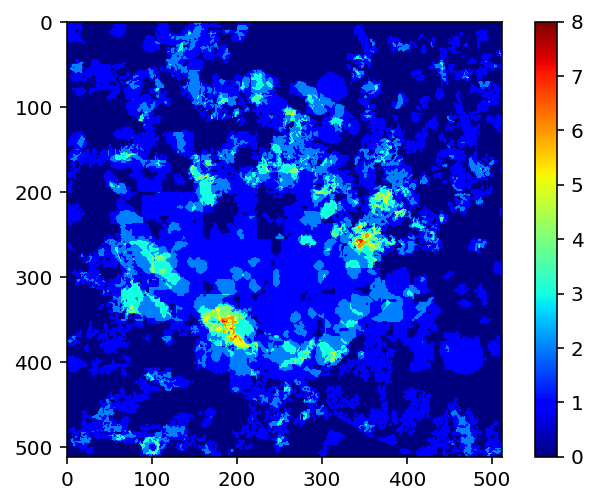

In [291]:
npxId = np.zeros(dims,dtype=np.int8)

Ab = A.astype(bool)

npxId.flat[:] = np.asarray(Ab.sum(axis=1)).flatten()

plt.imshow(npxId,cmap="jet")
plt.colorbar()

In [292]:
from collections import Counter

In [294]:
Counter(npxId.flatten()).most_common()

[(0, 123190),
 (1, 93878),
 (2, 32873),
 (3, 9147),
 (4, 2086),
 (5, 677),
 (6, 256),
 (7, 36),
 (8, 1)]

In [316]:
#a pixel with more Rois 
whichPxs = np.array(np.where(npxId==3)).T
ipx = whichPxs[np.random.choice(range(len(whichPxs)))]

In [317]:
iComps = smfind(Ab[ipx[0]*dims[0]+ipx[1]])[1]

(464, 479)

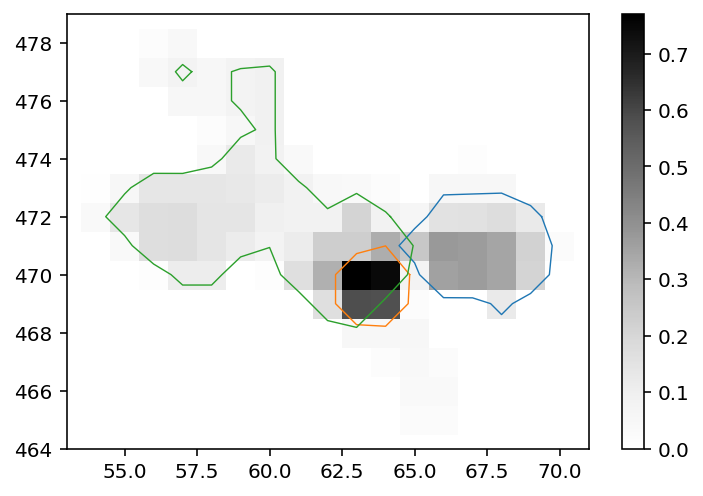

In [318]:
a = np.asarray(A[:,iComps].todense()).sum(-1).reshape(dims)
ax = plt.subplot(111)
i,j = np.where(a>0.001)
im = ax.imshow(a.T,cmap="Greys")
plt.colorbar(im)
for iComp in iComps:
    x,y = cnm.estimates.coordinates[iComp]["coordinates"].T
    plt.plot(x,y,lw=.7)
ax.set_aspect("equal")
plt.xlim(i.min()-1, i.max()+1)
plt.ylim(j.min()-1, j.max()+1)

In [309]:
a

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
def hv_view_patches(Yr, A, C, b, f, d1, d2, YrA=None, image_neurons=None, denoised_color=None, cmap='viridis'):
    """
    Interactive plotting utility for ipython notebook

    Args:
        Yr: np.ndarray
            movie

        A,C,b,f: np.ndarrays
            outputs of matrix factorization algorithm

        d1,d2: floats
            dimensions of movie (x and y)

        YrA:   np.ndarray
            ROI filtered residual as it is given from update_temporal_components
            If not given, then it is computed (K x T)

        image_neurons: np.ndarray
            image to be overlaid to neurons (for instance the average)

        denoised_color: string or None
            color name (e.g. 'red') or hex color code (e.g. '#F0027F')

        cmap: string
            name of colormap (e.g. 'viridis') used to plot image_neurons
    """

    nr, T = C.shape
    nA2 = np.ravel(np.power(A, 2).sum(0)) if type(
        A) == np.ndarray else np.ravel(A.power(2).sum(0))
    b = np.squeeze(b)
    f = np.squeeze(f)
    if YrA is None:
        Y_r = np.array(
            spdiags(old_div(1, nA2), 0, nr, nr) *
            (A.T * np.matrix(Yr) -
             (A.T * np.matrix(b[:, np.newaxis])) * np.matrix(f[np.newaxis]) -
             A.T.dot(A) * np.matrix(C)) + C)
    else:
        Y_r = C + YrA
    if image_neurons is None:
        image_neurons = A.mean(1).reshape((d1, d2), order='F')
    smp = cm.ScalarMappable(cmap=cmap)
    im_rgb = smp.to_rgba(image_neurons)[:, :, :3]
    im_hsv = mpl.colors.rgb_to_hsv(im_rgb)

    def norm(a, rg=(0, 1)):
        a_norm = (a - a.min()) / (a.max() - a.min())
        return a_norm * (rg[1] - rg[0]) + rg[0]

    Ad = np.asarray(A.todense()).reshape((d1, d2, -1), order='F')

    def plot_unit(uid, scl):
        trace = (
            hv.Curve(Y_r[uid, :], kdims='frame #').opts(framewise=True)
            * (hv.Curve(C[uid, :], kdims='frame #')
               .opts(color=denoised_color, framewise=True))
        ).opts(aspect=3, frame_height=200)
        A_scl = norm(Ad[:, :, uid], (scl, 1))
        im_hsv_scl = im_hsv.copy()
        im_hsv_scl[:, :, 2] = im_hsv[:, :, 2] * A_scl
        im_u = (hv.HSV(im_hsv_scl, kdims=['height', 'width'])
                .opts(aspect='equal', frame_height=200))
        return hv.Layout([im_u] + [trace]).cols(1) #im_u + trace

    return (hv.DynamicMap(plot_unit, kdims=['unit_id', 'scale'])
            .redim.range(unit_id=(0, nr-1), scale=(0.0, 1.0)))

In [167]:
old_div?

In [159]:
x#,y

array([         nan, 379.02823858, 379.03243861, 379.27268942,
       379.40911708, 379.45994542, 379.45994542, 379.        ,
       378.44044707, 378.        , 377.        , 376.39622422,
       376.        , 375.32717131, 375.36477213, 375.        ,
       374.36796443, 374.        , 373.        , 372.75366415,
       372.        , 371.78699537, 371.80082999, 371.78510345,
       371.68014241, 371.52257967, 371.47483091, 371.49269164,
       371.60835797, 371.61355478, 371.57723591, 372.        ,
       372.66221149, 373.        , 374.        , 375.        ,
       376.        , 377.        , 378.        , 378.39032955,
       379.        , 379.02823858,          nan, 381.29715458,
       381.40587314, 381.40587314, 381.10419483, 381.04534935,
       381.        , 380.12953496, 380.        , 379.        ,
       378.84483381, 378.19838753, 378.17141282, 378.34813617,
       378.53785311, 378.65001226, 379.        , 379.51505709,
       380.        , 380.76915131, 381.        , 381.29

In [66]:
ix = (slice(None), slice(50,150), slice(50,150))
cm.concatenate([
    m_orig[ix],
    np.ones_like(m_orig)[ix][:,:,:10]*np.nan,
    m_after_rigidmc[ix],
    np.ones_like(m_orig)[ix][:,:,:10]*np.nan,
    m_after_pwmc[ix],
],axis=2).play(fr=30,do_loop=True)

In [69]:
np.array(mc.x_shifts_els).shape

(80, 9)

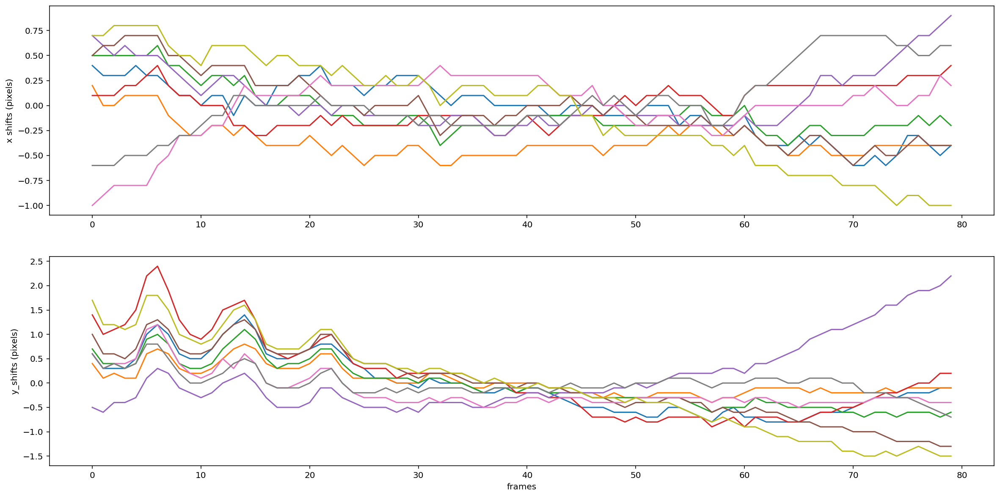

In [67]:
#%% visualize elastic shifts
plt.close()
plt.figure(figsize = (20,10))
plt.subplot(2, 1, 1)
plt.plot(mc.x_shifts_els)
plt.ylabel('x shifts (pixels)')
plt.subplot(2, 1, 2)
plt.plot(mc.y_shifts_els)
plt.ylabel('y_shifts (pixels)')
plt.xlabel('frames')
#%% compute borders to exclude
bord_px_els = np.ceil(np.maximum(np.max(np.abs(mc.x_shifts_els)),
                                 np.max(np.abs(mc.y_shifts_els)))).astype(np.int)

### Setup some parameters
We first set some parameters related to the data and motion correction and create a `params` object. We'll modify this object with additional settings later on. You can also set all the parameters at once as demonstrated in the `demo_pipeline.ipynb` notebook.

In [10]:
# # dataset dependent parameters
# frate = 2                      # movie frame rate
# decay_time = 2                 # length of a typical transient in seconds

# # motion correction parameters
# motion_correct = True    # flag for performing motion correction
# pw_rigid = False         # flag for performing piecewise-rigid motion correction (otherwise just rigid)
# gSig_filt = (3, 3)       # size of high pass spatial filtering, used in 1p data
# max_shifts = (5, 5)      # maximum allowed rigid shift
# strides = (48, 48)       # start a new patch for pw-rigid motion correction every x pixels
# overlaps = (24, 24)      # overlap between pathes (size of patch strides+overlaps)
# max_deviation_rigid = 3  # maximum deviation allowed for patch with respect to rigid shifts
# border_nan = 'copy'      # replicate values along the boundaries

# mc_dict = {
#     'fnames': fnames,
#     'fr': frate,
#     'decay_time': decay_time,
#     'pw_rigid': pw_rigid,
#     'max_shifts': max_shifts,
#     'gSig_filt': gSig_filt,
#     'strides': strides,
#     'overlaps': overlaps,
#     'max_deviation_rigid': max_deviation_rigid,
#     'border_nan': border_nan
# }

# opts = params.CNMFParams(params_dict=mc_dict)

### Load memory mapped file

In [28]:
# load memory mappable file
Yr, dims, T = cm.load_memmap(fname_new)
images = Yr.T.reshape((T,) + dims, order='F')

In [29]:
images.shape

(800, 256, 256)

In [30]:
m_orig.shape

(800, 256, 256)

In [31]:
fnames

['/Users/srdjan/Documents/Physio_Ca/data/Experiment28_Series041.tif']

In [36]:
m_orig[:].play(fr=100, magnification = 2)

### Parameter setting for CNMF-E
We now define some parameters for the source extraction step using the CNMF-E algorithm. 
We construct a new dictionary and use this to modify the *existing* `params` object,

In [82]:
# parameters for source extraction and deconvolution
p = 1               # order of the autoregressive system
K = None            # upper bound on number of components per patch, in general None
gSig = (3, 3)       # gaussian width of a 2D gaussian kernel, which approximates a neuron
gSiz = (13, 13)     # average diameter of a neuron, in general 4*gSig+1
Ain = None          # possibility to seed with predetermined binary masks
merge_thr = .7      # merging threshold, max correlation allowed
rf = 10             # half-size of the patches in pixels. e.g., if rf=40, patches are 80x80
stride_cnmf = 20    # amount of overlap between the patches in pixels
#                     (keep it at least large as gSiz, i.e 4 times the neuron size gSig)
tsub = 2            # downsampling factor in time for initialization,
#                     increase if you have memory problems
ssub = 1            # downsampling factor in space for initialization,
#                     increase if you have memory problems
#                     you can pass them here as boolean vectors
low_rank_background = None  # None leaves background of each patch intact,
#                     True performs global low-rank approximation if gnb>0
gnb = 0             # number of background components (rank) if positive,
#                     else exact ring model with following settings
#                         gnb= 0: Return background as b and W
#                         gnb=-1: Return full rank background B
#                         gnb<-1: Don't return background
nb_patch = 0        # number of background components (rank) per patch if gnb>0,
#                     else it is set automatically
min_corr = .8       # min peak value from correlation image
min_pnr = 10        # min peak to noise ration from PNR image
ssub_B = 2          # additional downsampling factor in space for background
ring_size_factor = 1.4  # radius of ring is gSiz*ring_size_factor

opts.change_params(params_dict={'method_init': 'corr_pnr',  # use this for 1 photon
                                'K': K,
                                'gSig': gSig,
                                'gSiz': gSiz,
                                'merge_thr': merge_thr,
                                'p': p,
                                'tsub': tsub,
                                'ssub': ssub,
                                'rf': rf,
                                'stride': stride_cnmf,
                                'only_init': True,    # set it to True to run CNMF-E
                                'nb': gnb,
                                'nb_patch': nb_patch,
                                'method_deconvolution': 'oasis',       # could use 'cvxpy' alternatively
                                'low_rank_background': low_rank_background,
                                'update_background_components': True,  # sometimes setting to False improve the results
                                'min_corr': min_corr,
                                'min_pnr': min_pnr,
                                'normalize_init': False,               # just leave as is
                                'center_psf': True,                    # leave as is for 1 photon
                                'ssub_B': ssub_B,
                                'ring_size_factor': ring_size_factor,
                                'del_duplicates': True,                # whether to remove duplicates from initialization
                                'border_pix': bord_px})                # number of pixels to not consider in the borders)

    52362396 [params.py:                 set():858] [5284] Changing key rf in group patch from None to 40
    52362397 [params.py:                 set():858] [5284] Changing key stride in group patch from None to 20
    52362398 [params.py:                 set():858] [5284] Changing key nb_patch in group patch from 1 to 0
    52362399 [params.py:                 set():858] [5284] Changing key low_rank_background in group patch from True to None
    52362399 [params.py:                 set():858] [5284] Changing key del_duplicates in group patch from False to True
    52362400 [params.py:                 set():858] [5284] Changing key p in group preprocess from 2 to 1
    52362401 [params.py:                 set():858] [5284] Changing key method_init in group init from greedy_roi to corr_pnr
    52362401 [params.py:                 set():858] [5284] Changing key K in group init from 30 to None
    52362402 [params.py:                 set():858] [5284] Changing key gSig in group init fro

CNMFParams:

data:

{'caiman_version': '1.6.3',
 'decay_time': 2,
 'dims': (512, 512),
 'dxy': (1, 1),
 'fnames': ['/Users/srdjan/Documents/Physio_Ca/data/Experiment28_Series041.tif'],
 'fr': 2,
 'last_commit': 'FILE-1571404903',
 'mmap_C': None,
 'mmap_F': None,
 'var_name_hdf5': 'mov'}

spatial_params:

{'block_size_spat': 5000,
 'dist': 3,
 'expandCore': array([[0, 0, 1, 0, 0],
       [0, 1, 1, 1, 0],
       [1, 1, 1, 1, 1],
       [0, 1, 1, 1, 0],
       [0, 0, 1, 0, 0]]),
 'extract_cc': True,
 'maxthr': 0.1,
 'medw': None,
 'method_exp': 'dilate',
 'method_ls': 'lasso_lars',
 'n_pixels_per_process': None,
 'nb': 0,
 'normalize_yyt_one': True,
 'nrgthr': 0.9999,
 'num_blocks_per_run_spat': 20,
 'se': array([[1, 1, 1],
       [1, 1, 1],
       [1, 1, 1]], dtype=uint8),
 'ss': array([[1, 1, 1],
       [1, 1, 1],
       [1, 1, 1]], dtype=uint8),
 'thr_method': 'nrg',
 'update_background_components': True}

temporal_params:

{'ITER': 2,
 'bas_nonneg': False,
 'block_size_temp': 5000,
 

### Inspect summary images and set parameters
Check the optimal values of `min_corr` and `min_pnr` by moving slider in the figure that pops up. You can modify them in the `params` object. 
Note that computing the correlation pnr image can be computationally and memory demanding for large datasets. In this case you can compute
only on a subset of the data (the results will not change). You can do that by changing `images[::1]` to `images[::5]` or something similar.
This will compute the correlation pnr image

In [83]:
# compute some summary images (correlation and peak to noise)
cn_filter, pnr = cm.summary_images.correlation_pnr(images[::1], gSig=gSig[0], swap_dim=False) # change swap dim if output looks weird, it is a problem with tiffile
# inspect the summary images and set the parameters
nb_inspect_correlation_pnr(cn_filter, pnr)

:Layout
   .AdjointLayout.Correlation :AdjointLayout
      :Image   [x,y]   (corr)
      :DynamicMap   []
         :Histogram   [corr]   (corr_frequency)
   .AdjointLayout.Pnr         :AdjointLayout
      :Image   [x,y]   (pnr)
      :DynamicMap   []
         :Histogram   [pnr]   (pnr_frequency)

You can inspect the correlation and PNR images to select the threshold values for `min_corr` and `min_pnr`. The algorithm will look for components only in places where these value are above the specified thresholds. You can adjust the dynamic range in the plots shown above by choosing the selection tool (third button from the left) and selecting the desired region in the histogram plots on the right of each panel.

In [84]:
# print parameters set above, modify them if necessary based on summary images
print(min_corr) # min correlation of peak (from correlation image)
print(min_pnr)  # min peak to noise ratio

0.8
10


### Run the CNMF-E algorithm

In [85]:
cnm = cnmf.CNMF(n_processes=n_processes, dview=dview, Ain=Ain, params=opts)
cnm.fit(images)

    55195261 [params.py:                 set():858] [5284] Changing key n_processes in group patch from 1 to 8
    55195263 [params.py:                 set():858] [5284] Changing key init_batch in group online from 200 to 8000
    55195264 [cnmf.py:                 fit():468] [5284] (8000, 512, 512)
    55195264 [params.py:                 set():858] [5284] Changing key medw in group spatial from None to (3, 3)
    55195266 [cnmf.py:                 fit():485] [5284] Using 8 processes
    55195270 [params.py:                 set():858] [5284] Changing key n_pixels_per_process in group preprocess from None to 6510
    55195271 [params.py:                 set():858] [5284] Changing key n_pixels_per_process in group spatial from None to 6510
    55195271 [cnmf.py:                 fit():496] [5284] using 6510 pixels per process
    55195272 [cnmf.py:                 fit():497] [5284] using 5000 block_size_spat
    55195273 [cnmf.py:                 fit():498] [5284] using 5000 block_size_t

In [211]:
cnm.save(fname_mc[0].replace(".mmap",".hdf5"))
# ("")

/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/caiman/utils/utils.py:441: H5pyDeprecationWarning: dataset.value has been deprecated. Use dataset[()] instead.
  if not np.array_equal(h5file[path + key].value, item):
/Users/srdjan/anaconda2/envs/caiman/lib/python3.7/site-packages/caiman/utils/utils.py:432: H5pyDeprecationWarning: dataset.value has been deprecated. Use dataset[()] instead.
  if not h5file[path + key].value == item:
    63128179 [utils.py:recursively_save_dict_contents_to_group():447] [5284] A is sparse ****
    63130758 [utils.py:recursively_save_dict_contents_to_group():447] [5284] W is sparse ****
    63131493 [utils.py:recursively_save_dict_contents_to_group():414] [5284] g is an object type
    63131509 [utils.py:recursively_save_dict_contents_to_group():422] [5284] ['groups', 'idx_tot', 'ind_A', 'Ab_epoch', 'coordinates', 'loaded_model', 'optional_outputs', 'merged_ROIs', '** not saved']
    63131510 [utils.py:recursively_save_dict_contents_to_group(

### Alternate way to run the pipeline at once
It is possible to run the combined steps of motion correction, memory mapping, and cnmf fitting in one step as shown below. The command is commented out since the analysis has already been performed. It is recommended that you familiriaze yourself with the various steps and the results of the various steps before using it.

In [86]:
# cnm1 = cnmf.CNMF(n_processes, params=opts, dview=dview)
# cnm1.fit_file(motion_correct=motion_correct)

## Component Evaluation

The processing in patches creates several spurious components. These are filtered out by evaluating each component using three different criteria:

- the shape of each component must be correlated with the data at the corresponding location within the FOV
- a minimum peak SNR is required over the length of a transient
- each shape passes a CNN based classifier

<img src="../../docs/img/evaluationcomponent.png"/>
After setting some parameters we again modify the existing `params` object.

In [87]:
#%% COMPONENT EVALUATION
# the components are evaluated in three ways:
#   a) the shape of each component must be correlated with the data
#   b) a minimum peak SNR is required over the length of a transient
#   c) each shape passes a CNN based classifier

min_SNR = 3            # adaptive way to set threshold on the transient size
r_values_min = 0.85    # threshold on space consistency (if you lower more components
#                        will be accepted, potentially with worst quality)
cnm.params.set('quality', {'min_SNR': min_SNR,
                           'rval_thr': r_values_min,
                           'use_cnn': False})
cnm.estimates.evaluate_components(images, cnm.params, dview=dview)

print(' ***** ')
print('Number of total components: ', len(cnm.estimates.C))
print('Number of accepted components: ', len(cnm.estimates.idx_components))

    57175298 [params.py:                 set():858] [5284] Changing key min_SNR in group quality from 2.5 to 3
    57175300 [params.py:                 set():858] [5284] Changing key rval_thr in group quality from 0.8 to 0.85
    57175301 [params.py:                 set():858] [5284] Changing key use_cnn in group quality from True to False
    57175488 [components_evaluation.py:estimate_components_quality():696] [5284] Component evaluation in parallel


 ***** 
Number of total components:  1845
Number of accepted components:  1680


### Do some plotting

In [88]:
#%% plot contour plots of accepted and rejected components
cnm.estimates.plot_contours_nb(img=cn_filter, idx=cnm.estimates.idx_components)

View traces of accepted and rejected components. Note that if you get data rate error you can start Jupyter notebooks using:
'jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10'

In [92]:
len(cnm.estimates.coordinates)

1845

In [97]:
plt.imshow(cn_filter)

In [122]:
cnm.estimates.SNR_comp.shape

(1845,)

In [144]:
maxDims = []
for coords in cnm.estimates.coordinates:
    maxDims += [np.max(np.nanmax(coords["coordinates"][1:-1],axis=0)-
                       np.nanmin(coords["coordinates"][1:-1],axis=0))]

In [147]:
maxDims = np.array(maxDims)

In [191]:
%matplotlib inline

    62156446 [pyplot.py:      switch_backend():225] [5284] Loaded backend module://ipykernel.pylab.backend_inline version unknown.


In [192]:
%config InlineBackend.figure_format = 'retina'

    62233425 [ticker.py:         tick_values():2300] [5284] vmin 0.6865942807383837 vmax 2687.176476354904
    62233426 [ticker.py:         tick_values():2351] [5284] ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03, 1.e+04, 1.e+05])
    62233436 [ticker.py:         tick_values():2300] [5284] vmin 0.6865942807383837 vmax 2687.176476354904
    62233437 [ticker.py:         tick_values():2351] [5284] ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03, 1.e+04, 1.e+05])
    62233440 [ticker.py:         tick_values():2300] [5284] vmin 0.6865942807383837 vmax 2687.176476354904
    62233441 [ticker.py:         tick_values():2351] [5284] ticklocs array([2.e-02, 3.e-02, 4.e-02, 5.e-02, 6.e-02, 7.e-02, 8.e-02, 9.e-02,
       2.e-01, 3.e-01, 4.e-01, 5.e-01, 6.e-01, 7.e-01, 8.e-01, 9.e-01,
       2.e+00, 3.e+00, 4.e+00, 5.e+00, 6.e+00, 7.e+00, 8.e+00, 9.e+00,
       2.e+01, 3.e+01, 4.e+01, 5.e+01, 6.e+01, 7.e+01, 8.e+01, 9.e+01,
       2.e+02, 3.e+02, 4.e+02, 5.e+02, 6.e+0

    62233898 [ticker.py:         tick_values():2351] [5284] ticklocs array([2.e-02, 3.e-02, 4.e-02, 5.e-02, 6.e-02, 7.e-02, 8.e-02, 9.e-02,
       2.e-01, 3.e-01, 4.e-01, 5.e-01, 6.e-01, 7.e-01, 8.e-01, 9.e-01,
       2.e+00, 3.e+00, 4.e+00, 5.e+00, 6.e+00, 7.e+00, 8.e+00, 9.e+00,
       2.e+01, 3.e+01, 4.e+01, 5.e+01, 6.e+01, 7.e+01, 8.e+01, 9.e+01,
       2.e+02, 3.e+02, 4.e+02, 5.e+02, 6.e+02, 7.e+02, 8.e+02, 9.e+02,
       2.e+03, 3.e+03, 4.e+03, 5.e+03, 6.e+03, 7.e+03, 8.e+03, 9.e+03,
       2.e+04, 3.e+04, 4.e+04, 5.e+04, 6.e+04, 7.e+04, 8.e+04, 9.e+04,
       2.e+05, 3.e+05, 4.e+05, 5.e+05, 6.e+05, 7.e+05, 8.e+05, 9.e+05])
    62233918 [ticker.py:         tick_values():2300] [5284] vmin 0.6865942807383837 vmax 2687.176476354904
    62233920 [ticker.py:         tick_values():2351] [5284] ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03, 1.e+04, 1.e+05])
    62233923 [ticker.py:         tick_values():2300] [5284] vmin 0.6865942807383837 vmax 2687.176476354904
    622

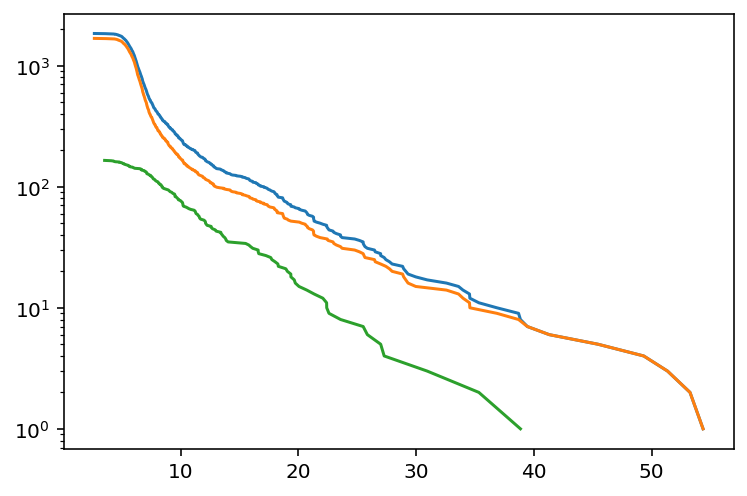

In [197]:
# %%capture
ax = plt.subplot(111)
for x in [maxDims,maxDims[cnm.estimates.idx_components],maxDims[cnm.estimates.idx_components_bad]]:
#     ax.plot(sorted(x),np.linspace(0,1,len(x)+1)[1:][::-1])
    ax.plot(sorted(x),np.arange(1,len(x)+1)[::-1])
ax.set_yscale("log")
#     ax.hist(x,np.linspace(0,50,101), histtype="step")

In [198]:
idInteresting = np.argsort(-maxDims)[0]

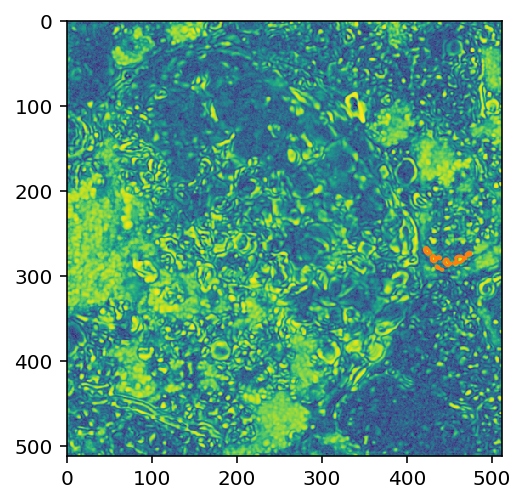

In [199]:
x,y = cnm.estimates.coordinates[idInteresting]["coordinates"].T

plt.imshow(cn_filter)
plt.plot([])
plt.plot(x-.5,y-.5)


In [159]:
# cnm.estimates.hv_view_components()

In [200]:
cnm.estimates.hv_view_components??

In [201]:
cm.utils.visualization.hv_view_patches??

In [172]:
# strange components
cnm.estimates.hv_view_components(
    img=cn_filter,
    idx=np.argsort(-maxDims)[:10],
    denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)

In [212]:
# accepted components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)

In [213]:
# rejected components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components_bad,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)

### Stop cluster

In [ ]:
cm.stop_server(dview=dview)

### Some instructive movies
Play the reconstructed movie alongside the original movie and the (amplified) residual

In [ ]:
# with background 
cnm.estimates.play_movie(images, q_max=99.5, magnification=2,
                                 include_bck=True, gain_res=10, bpx=bord_px)

In [ ]:
# without background
cnm.estimates.play_movie(images, q_max=99.9, magnification=2,
                                 include_bck=False, gain_res=4, bpx=bord_px)